<!--start-block-->
<hr style="height: 1px;">
<i>This notebook was authored by the 8.316 Course Team, Copyright 2023 MIT All Rights Reserved.</i>
<hr style="height: 1px;">
<br>

<h1>PSet 4: Simulation</h1>

<br>

<!--start-block MIT color #A31F34-->
<a name='section_4_0'></a>
<hr style="height: 1px;">

## <h2 style="border:1px; border-style:solid; padding: 0.25em; color: #FFFFFF; background-color: #90409C">P4.0 Overview</h2>

<h3>Learning Objectives</h3>

The goal of this problem set is to program simulation of physical systems, and infer properties of the system using the simulation.

The first part focuses on 2D ideal gas simulation through particle level simulation. 
In this part, we will derive macroscopic physical laws from microscopic particle level simulation. 
Wwe will derive famous distributions and relations such as Boltzmann distribution, Gay-Lussac's law, Avogadro's Law, Boyle's law, and by combining them all, ideal gas relation in two dimensions. 

<h3>Importing Libraries</h3>

Before beginning, run the cell below to import the relevant libraries for this notebook.

In [1]:
%matplotlib inline
import itertools
from IPython.display import HTML
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
from matplotlib import animation
from matplotlib.animation import PillowWriter

<h3>Setting Default Figure Parameters</h3>

The following code cell sets default values for figure parameters.

In [2]:
#>>>RUN: P1.0-runcell02

#set plot resolution
%config InlineBackend.figure_format = 'retina'

#set default figure parameters
plt.rcParams['figure.figsize'] = (9,6)

medium_size = 12
large_size = 15

plt.rc('font', size=medium_size)          # default text sizes
plt.rc('xtick', labelsize=medium_size)    # xtick labels
plt.rc('ytick', labelsize=medium_size)    # ytick labels
plt.rc('legend', fontsize=medium_size)    # legend
plt.rc('axes', titlesize=large_size)      # axes title
plt.rc('axes', labelsize=large_size)      # x and y labels
plt.rc('figure', titlesize=large_size)    # figure title

<!--start-block-->
<a name='section_4_1'></a>
<hr style="height: 1px;">

## <h2 style="border:1px; border-style:solid; padding: 0.25em; color: #FFFFFF; background-color: #90409C">P4.1 Obtaining Maxwell-Boltzmann distribution from Molecular Simulation</h2>

| [Top](#section_4_0) | [Problems](#exercises_4_1) | [Next Section](#section_4_2) |

<h3>Overview</h3>

In this section, you will code the microscopic simulation of ideal gas, where the particles move freely inside a stationary container without interacting with one another, except for very brief collisions in which they exchange energy and momentum with each other or with their thermal environment. 
|
Then we will derive $\href{https://en.wikipedia.org/wiki/Maxwell%E2%80%93Boltzmann_distribution}{\text{Maxwell-Boltzmann distribution}}$, which describes velocity distribution of these idela gas particles, using the microscopic simulation. 




### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.1.1</span>

Elastic Collision against a wall. 

We know that for elastic collsion of a mass with a wall (stationary infinite mass object), the velocity component perpendicular to the wall flips direction, while the horizontal component stays the same. 

<p align="center">
<img alt="Wall Collision" src="./images/wall_collision.png" width="300"/>
</p>

$$v_{f, \perp} = -v_{i,\perp} $$

$$v_{f, \parallel} = v_{i,\parallel} $$


Complete the code for `wall_collision`, which takes as input `pos` and `vel` that represents position and velocity vectors of particles, and returns the velocity vectors 
after the collsion with four sides of the wall. Assume that both `pos` and `vel` have shape `[n_particles, 2]`. 

Assume that the 2D box is a square with side length `L` equal to 1. 

In [ ]:
def wall_collision(pos, vel):

    #collsion with the right wall 
    vel[pos[:, 0] > 1, 0] = #Your code goes here
    
    #collision with the left wall 
    vel[pos[:, 0] < 0, 0] = #Your code goes here

    #collision with the top wall 
    vel[pos[:, 1] > 1, 1] = #Your code goes here

    #collsion with the bottom wall 
    vel[pos[:, 1] < 0, 1] = #Your code goes here
    return vel 

In [3]:
def wall_collision(pos, vel):

    #collsion with the right wall 
    vel[pos[:, 0] > 1, 0] = -np.abs(vel[pos[:, 0] > 1, 0])
    
    #collision with the left wall 
    vel[pos[:, 0] < 0, 0] = np.abs(vel[pos[:, 0] < 0, 0])

    #collision with the top wall 
    vel[pos[:, 1] > 1, 1] = -np.abs(vel[pos[:, 1] > 1, 1])

    #collsion with the bottom wall 
    vel[pos[:, 1] < 0, 1] = np.abs(vel[pos[:, 1] < 0, 1])
    return vel 

<h3>Let's run a simulation of a single particle bouncing off four side of the walls using the above code you completed. </h3>

### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.1.2</span>

Now let's code up a single particle simulation. 

The simulation will run in time steps `dt`, which is set to be a very small value. 

First, in each time step, we handle the wall collision of the particle, and flip the component of the velocity vector using function `wall_collision` we coded above. 

Then, we use the position update formula $$\vec{x}_{i+1} = \vec{x}_{i} + dt \cdot \vec{v}_{i+1}$$ 

which is discretizing the continuous relation $$\vec{v} = \frac{d\vec{x}}{dt} $$

We save all the simulated position and velocity vectors in arrays of shape `[time_steps, n_particles ,2]`, where `n_particles` is equal to 1 in this case since we are simulating a single particle, and the last dimension saves the `x` and the `y` component of that particle.

Enter the x component of the position of the following particle in step 1111 rounded to 2 significant digits. 

In [ ]:
# Your code here
def simulate_wall(pos, vel, time_steps, dt):
    n_particles = pos.shape[0]
    pos_simulated = np.zeros((time_steps,n_particles, 2))
    vel_simulated = np.zeros((time_steps,n_particles, 2))

    pos_simulated[0] = pos
    vel_simulated[0] = vel
    
    for i in range(1,time_steps):
        #Your code here
        
    return pos_simulated, vel_simulated

# Use this function to print the answer
#pos_sim, vel_sim = simulate_wall(np.array([[0.5,0.5]]), np.array([[200.0,100.0]]), 8000, 0.0001)
#print(pos_sim[1111][0])

In [4]:
# Your code here
def simulate_wall(pos, vel, time_steps, dt):
    n_particles = pos.shape[0]
    pos_simulated = np.zeros((time_steps,n_particles, 2))
    vel_simulated = np.zeros((time_steps,n_particles, 2))

    pos_simulated[0] = pos
    vel_simulated[0] = vel
    
    for i in range(1,time_steps):
        vel = wall_collision(pos, vel)
        pos = pos + vel * dt    
        vel_simulated[i] = vel
        pos_simulated[i] = pos
        
    return pos_simulated, vel_simulated

# Use this function to print the answer
pos_sim, vel_sim = simulate_wall(np.array([[0.5,0.5]]), np.array([[200.0,100.0]]), 8000, 0.0001)
print(pos_sim[1111][0])

[0.72 0.39]


In [5]:
pos_sim, vel_sim = simulate_wall(np.array([[0.5,0.5]]), np.array([[200.0,100.0]]), 8000, 0.0001)

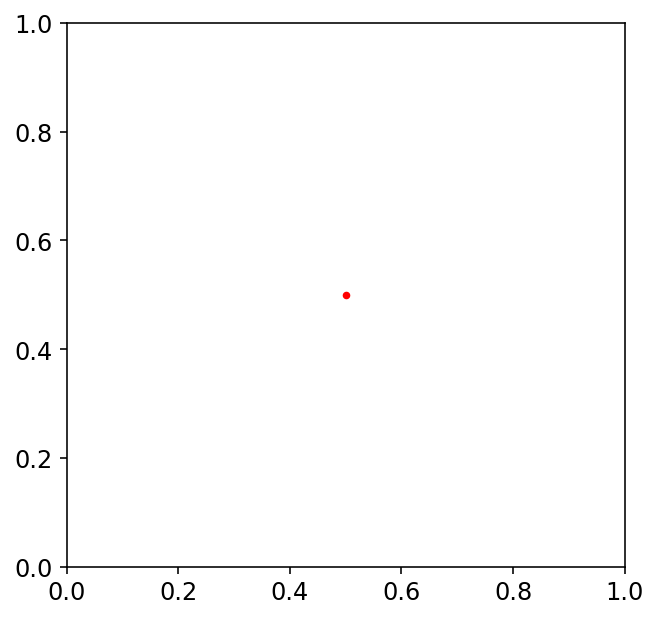

In [6]:
fig, ax = plt.subplots(1,1,figsize=(5,5))
ax.clear()
vmin = 0
vmax = 1
ax.set_xlim(0,1)
ax.set_ylim(0,1)
markersize = 2 * 0.005 * ax.get_window_extent().width  / (vmax-vmin) * 72./fig.dpi
red, = ax.plot([], [], 'o', color='red', markersize=markersize)

def animate(i):
    xred, yred = pos_sim[i][:,0], pos_sim[i][:,1]
    red.set_data(xred, yred)
    return [red]


ani = animation.FuncAnimation(fig, animate, frames=500, interval=50, blit=True)

In [9]:
HTML(ani.to_jshtml())


<h3> Interparticle Collisions </h3>

Now let's write code that handles interparticle collisions. 

The ideal gas molecules doesn't interact with one another except for very brief collisions in which they exchange energy and momentum with each other or with their thermal environment.

For ideal gas, all interparticle collisions will be elastic collsions. 



### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.1.3</span>

When two particles get closer 2 times the radius of the particle, we should perform elastic collision of particles. 

For practical implementation, in each simulation step, we need to track which pair of particles collide. 

In order to detect collision, first we have to calculate the center of mass distances between each particles. 

For bookkeeping indices, we give `n_particles` indices `0,1,...,n_particles-1`. 

Given position vectors `position` of shape `[n_particles, 2]` and an array of index pair `idx_pair` of shape `[n_pair, 2]` where each row is `[index_particle1, index_particle2]`, write a function that computes an array of shape `[n_pair]`, which is a pairwise distance of particles between every index pair of particles.  

For a given position and idx_pair arrays, enter the resulting distance_pairs vectors' 0, 23, 234, 444th entry. 

In [ ]:
# helper function that calculates distance between particles of given index pair
# maybe turn that into problem?
def compute_distance_pairs(position, idx_pair):
    delta_x = #Your code goes here
    delta_y = #Your code goes here
    distances = #np.sqrt(delta_x**2 + delta_y**2)
    return distances


np.random.seed(0x98a09fe)
n_particles = 50 #number of particles
pos_initial = np.random.rand(n_particles, 2)
indices = np.arange(0,n_particles,1)
idx_pair = np.array(list(itertools.combinations(indices,2)))
#print(compute_distance_pairs(pos_initial, idx_pair)[[0,23,234,444]])
#inditial position of particles
#np.random.seed(908)


In [7]:
# helper function that calculates distance between particles of given index pair
# maybe turn that into problem?
def compute_distance_pairs(position, idx_pair):
    delta_x = position[:,0][idx_pair][:,0] - position[:,0][idx_pair][:,1]
    delta_y = position[:,1][idx_pair][:,0] - position[:,1][idx_pair][:,1]
    distances = np.sqrt(delta_x**2 + delta_y**2)
    return distances


np.random.seed(0x98a09fe)
n_particles = 50 #number of particles
pos_initial = np.random.rand(n_particles, 2)
indices = np.arange(0,n_particles,1)
idx_pair = np.array(list(itertools.combinations(indices,2)))
print(compute_distance_pairs(pos_initial, idx_pair)[[0,23,234,444]])
#inditial position of particles
#np.random.seed(908)


[0.30366182 0.72319803 0.44839845 0.43339836]


### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.1.4</span>

Now, given a distance pair array for a given array of index pairs, we need to calculate which pairs actually collide, meaning they satisfy the condition that the center of mass distance between a pair of particles is smaller than `2*particle_radius`

Write a simple function that takes as an input `distance_pairs` and returns an array of indices of `idx_pairs` of pairs that collide.
Enter indices of pairs that collide. 

In [18]:
def which_pair_collides(distance_pairs):
    #Your code goes here
    pass

particle_radius = 0.01
distance_pairs = compute_distance_pairs(pos_initial, idx_pair)
which_pair_collides(distance_pairs)

In [8]:
def which_pair_collides(distance_pairs):
    return np.where(distance_pairs < 2*particle_radius)[0]

particle_radius = 0.01
distance_pairs = compute_distance_pairs(pos_initial, idx_pair)
which_pair_collides(distance_pairs)

array([194, 610, 772])

### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.1.5</span>

Elastic Collsion of Particles. 


<p align="center">
<img alt="unit circle wave decomposition" src="https://upload.wikimedia.org/wikipedia/commons/2/2c/Elastischer_sto%C3%9F_2D.gif" width="800"/>
</p>

>source: https://commons.wikimedia.org/wiki/File:Animation_zum_Verst%C3%A4ndnis_der_Fourierentwicklung.gif<br>
>attribution: PZim, CC BY-SA 3.0 <https://creativecommons.org/licenses/by-sa/3.0>, via Wikimedia Commons

    
When two particles get closer 2 times the radius of the particle, we should perform elastic collision of particles. 

So at each iteration of the simulation, we will evaluate `d_pairs`, and if any of the distances between particles is less than $2r$, then a collision occurs. What is the final velocity of each of the two spheres? In an elastic collision (conservation of energy + momentum + angular momentum, although in this case we neglect angular momentum), one can show

$$\vec{v}_1^{\text{new}} = \vec{v}_1 - \frac{(\vec{v}_1 - \vec{v}_2) \cdot (\vec{r}_1 - \vec{r}_2)}{|\vec{r}_1 - \vec{r}_2|^2} (\vec{r}_1 - \vec{r}_2)$$
$$\vec{v}_2^{\text{new}} = \vec{v}_2 - \frac{(\vec{v}_2 - \vec{v}_1) \cdot (\vec{r}_2 - \vec{r}_1)}{|\vec{r}_1 - \vec{r}_2|^2} (\vec{r}_2 - \vec{r}_1)$$

You can read more about it in $\href{https://en.wikipedia.org/wiki/Elastic_collision}{\text{Wikipedia}}$ or any intro to mechanics class textbook. 


Complete the code for `pair_collsion`, which takes as input `pos_1i`, `pos_2i`, `vel_1i` and `vel_2i` that represents position and velocity vectors of particles, and returns the velocity vectors 
after the collsion with four sides of the wall.

For given particles that collide, enter x, y velocity components of the first particle.

In [9]:
def pair_collision(pos_1i, pos_2i, vel_1i, vel_2i):

    vel_1f = vel_1i - (np.sum( (pos_1i-pos_2i) * (vel_1i-vel_2i),axis=1)/np.sum((pos_1i-pos_2i)**2, axis=1)).T @ (pos_1i - pos_2i)
    vel_2f = vel_2i - (np.sum( (pos_1i-pos_2i) * (vel_1i-vel_2i),axis=1)/np.sum((pos_1i-pos_2i)**2, axis=1)).T @ (pos_2i - pos_1i)

    return vel_1f, vel_2f


    

### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.1.6</span>

Full simulation.
Let's edit the `simulate` function we coded earlier to incorporate all particlewise collisions. 

`idx_pair` variable keeps index pairs of every possible pair of particles. 

We will handle pairwise collision as the first action in each loop, and wall collision afterwards. 

For a given position and idx_pair arrays, enter the resulting distance_pairs vectors' 0, 23, 234, 444th entry. 

In [10]:
def simulate(pos, vel, time_steps, dt):

    
    nparticles = pos.shape[0]
    indices = np.arange(0,n_particles,1)
    idx_pair = np.array(list(itertools.combinations(indices,2)))

    
    pos_simulated = np.zeros((time_steps, n_particles, 2))
    vel_simulated = np.zeros((time_steps, n_particles, 2))


    

    
    pos_simulated[0] = pos
    vel_simulated[0] = vel

    for i in range(1,time_steps):


        collision_idx = which_pair_collides(compute_distance_pairs(pos, idx_pair))
        v1f, v2f = pair_collision(pos[idx_pair[collision_idx][:,0]], pos[idx_pair[collision_idx][:,1]],
                                  vel[idx_pair[collision_idx][:,0]], vel[idx_pair[collision_idx][:,1]])

        vel[idx_pair[collision_idx][:,0]] = v1f
        vel[idx_pair[collision_idx][:,1]] = v2f

        vel = wall_collision(pos, vel)

        pos = pos + vel * dt
        

        vel_simulated[i] = vel
        pos_simulated[i] = pos

    return pos_simulated, vel_simulated

<h3>Setting Parameters of our Simulation</h3>

In [11]:
np.random.seed(4150032420)
n_particles = 65 #number of particles
pos_initial = np.random.rand(n_particles, 2) #inditial position of particles
particle_radius = 0.003 #radius of individual particles
L = 1 #side length of the box
# Setting up the initial 2D velocities of particles
vel_initial = np.zeros((n_particles,2))
vel_initial[pos_initial[:,0]>=L/2, 0] = -100
vel_initial[pos_initial[:,0]<L/2, 0] = 100
vel_initial[:, 1] = 0


In [12]:
pos_sim, vel_sim = simulate(pos_initial, vel_initial, 5000, 0.0001)

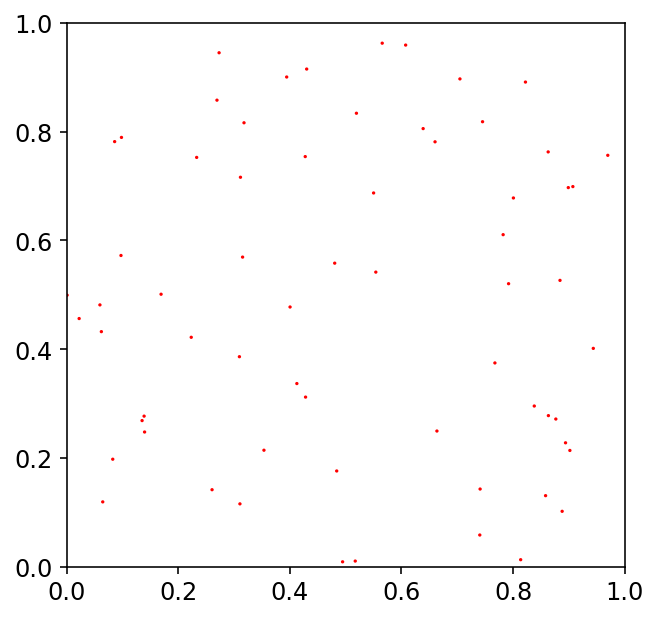

In [51]:
fig, ax = plt.subplots(1,1,figsize=(5,5))
xred, yred = pos_initial[:,0], pos_initial[:,1]
circles_red = [plt.Circle((xi, yi), radius=particle_radius, linewidth=0) for xi,yi in zip(xred,yred)]
cred = matplotlib.collections.PatchCollection(circles_red, facecolors='red')
ax.add_collection(cred)
ax.set_xlim(0,1)
ax.set_ylim(0,1)
plt.show()

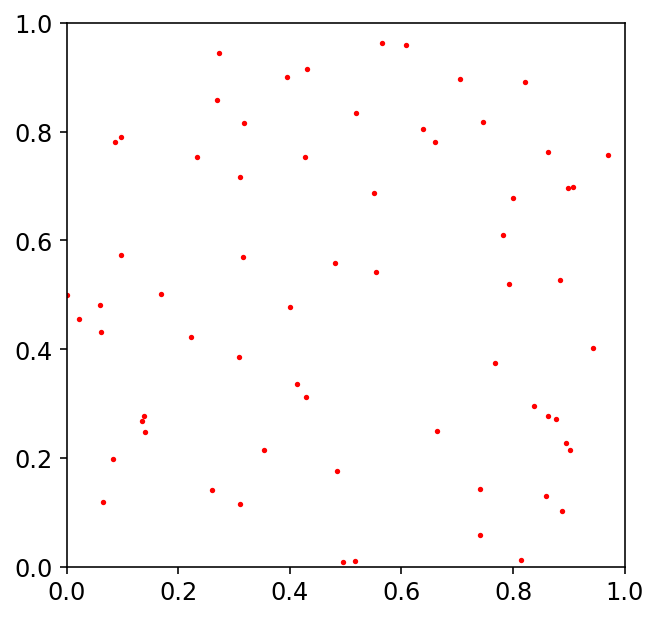

In [52]:
fig, ax = plt.subplots(1,1,figsize=(5,5))
ax.clear()
vmin = 0
vmax = 1
ax.set_xlim(0,1)
ax.set_ylim(0,1)
markersize = 2 * particle_radius * ax.get_window_extent().width  / (vmax-vmin) * 72./fig.dpi
red, = ax.plot([], [], 'o', color='red', markersize=markersize)

def animate(i):
    xred, yred = pos_sim[i][:,0], pos_sim[i][:,1]
    red.set_data(xred, yred)
    return [red]



ani = animation.FuncAnimation(fig, animate, frames=500, interval=50, blit=True)

In [53]:
HTML(ani.to_jshtml())


### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.1.7</span>

Maxwell-Boltzmann Distribution

Now, let's run the simulation until it reaches thermal equilibrium, and then compare the final velocity distribution of the particles and compare it to Maxwell-Boltzmann in 2 Dimensions:

Using equipartition theorem ($\href{https://en.wikipedia.org/wiki/Equipartition_theorem}{\text{Wikipedia}}$), in thermal equilibrium, each degree of freedom contributes $\frac{1}{2}k_B T$ to the average energy. 

In 2-dimensional space, the degree of freedom is 2. 

* $d \times \frac{1}{2}k_B T = 2 \times \frac{1}{2}k_B T = KE_{avg} = \frac{1}{2}m\bar{v^2} \implies \boxed{\frac{m}{kT} = \frac{2}{\bar{v^2}}}$
* $\boxed{f(v) = \frac{m}{kT} v \exp\left(-\frac{m}{kT}\frac{v^2}{2} \right)}$

* Now, use the fact that initial velocity is set to $500 m/s$ to calculat the value of $\frac{m}{kT}$
* Write a function for the fit function, and enter pdf value of f(100) (where unit is $m/s$)

In [15]:
v = np.linspace(0, 2000, 1001)

def maxwell_boltzmann(v):    
    a = 2/500**2
    fv = a*v*np.exp(-a*v**2 / 2)
    return fv

print(maxwell_boltzmann(v)[np.where(v==100)[0]])

[0.00076863]


In [16]:
np.random.seed(673720454)
n_particles = 400
pos_initial = np.random.rand(n_particles, 2)

particle_radius = 0.0002
vel_initial = np.zeros((n_particles,2))
thetas = np.random.rand(n_particles)* 2 * np.pi
vel_initial[:, 0] = np.cos(thetas) * 500
vel_initial[:, 1] = np.sin(thetas) * 500



In [17]:
# This can take a while to run...
pos_sim, vel_sim = simulate(pos_initial, vel_initial, 40000, 0.0000008)

In [18]:
#v = np.linspace(0, 2000, 1000)
#a = 2/500**2
#fv = a*v*np.exp(-a*v**2 / 2)

Text(0, 0.5, '# Particles')

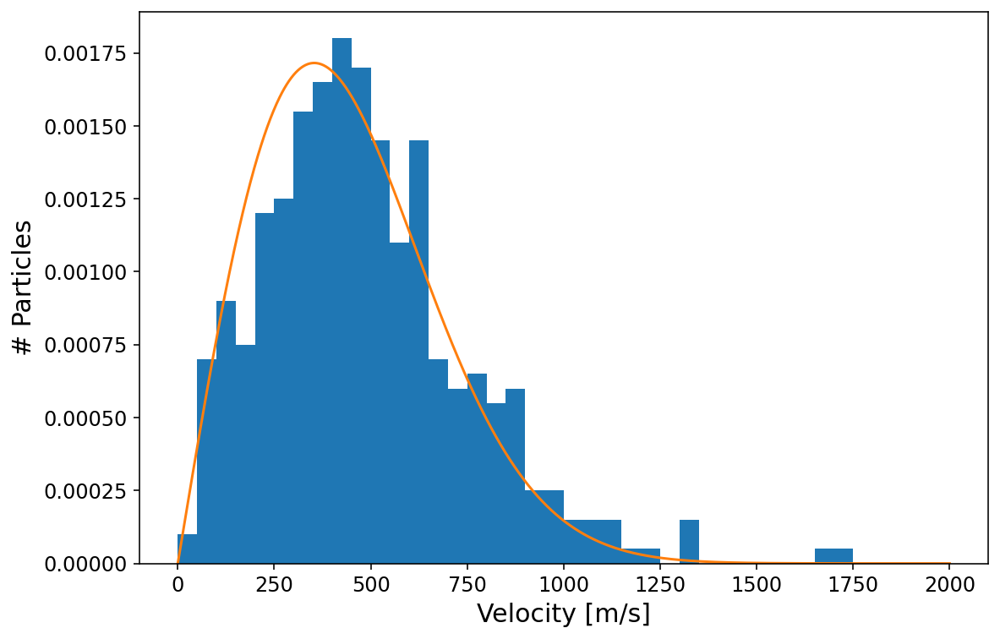

In [19]:

bins = np.linspace(0,2000,41)
plt.figure()
plt.hist(np.sqrt(np.sum(vel_sim[-1]**2, axis=1)), bins=bins, density=True)
plt.plot(v,maxwell_boltzmann(v))
plt.xlabel('Velocity [m/s]')
plt.ylabel('# Particles')



<h3>Now let's turn that into an animation</h3>

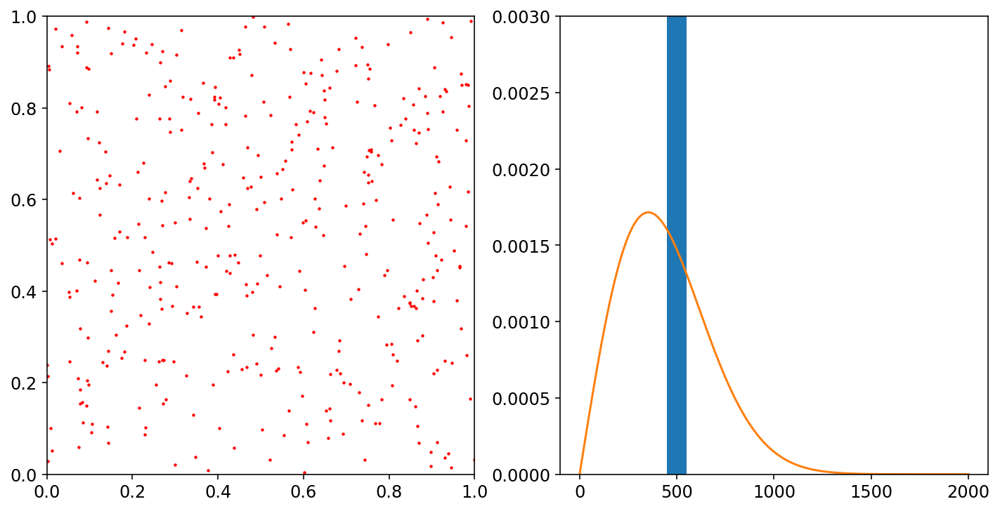

In [65]:
fig, axes = plt.subplots(1, 2, figsize=(12,6))
axes[0].clear()
vmin = 0
vmax = 1
axes[0].set_xlim(0,1)
axes[0].set_ylim(0,1)
markersize = 10*2 * particle_radius * axes[0].get_window_extent().width  / (vmax-vmin) * 72./fig.dpi
red, = axes[0].plot([], [], 'o', color='red', markersize=markersize)
n, bins, patches = axes[1].hist(np.sqrt(np.sum(vel_sim[0]**2, axis=1)), bins=bins, density=True)
axes[1].plot(v,maxwell_boltzmann(v))
axes[1].set_ylim(top=0.003)

def animate(i):
    xred, yred = pos_sim[i][:,0], pos_sim[i][:,1]
    red.set_data(xred, yred)
    hist, _ = np.histogram(np.sqrt(np.sum(vel_sim[i]**2, axis=1)), bins=bins, density=True)
    for i, patch in enumerate(patches):
        patch.set_height(hist[i])
    return [red]

from itertools import chain
ani_hist = animation.FuncAnimation(fig, animate, frames=range(0,40000,100), interval=50, blit=True)
#list(chain(range(100),range(100, 39500, 100), range(39500, 40000)))

In [66]:
HTML(ani_hist.to_jshtml())


<h3>with some simple simulation, we were able to obtain Maxwell-Boltzmann distribution!</h3>

<!--start-block-->
<a name='section_4_2'></a>
<hr style="height: 1px;">

## <h2 style="border:1px; border-style:solid; padding: 0.25em; color: #FFFFFF; background-color: #90409C">P4.2 Ideal Gas Law</h2>

| [Top](#section_4_0) | [Previous Section](#section_4_1) | [Problems](#exercises_4_3) | [Next Section](#section_4_3) |

<h3>Overview</h3>

Now with the setup we just completed, we will derive ideal gas relations.

Ideal gas law combines Gay-Lussac's law, and Avogadro's law, and Boyle's law.

We will confirm each of them through our molecular simulation, and in order to do that we will compute macroscopic quantities such as pressure based on the microscopic components

In real life, its easier to keep the pressure constant to atmospheric presure, and vary the volume. 

However, in simulations, it's easier to keep the volume constant and measure the pressure change. 

Therefore for the case of Avogadro's law we will show a version where we keep the volume constant and vary the number of particles and observe the pressure.  

<h3>Gay-Lussac's Law</h3>

Firstly, we will check Gay-Lussac's law, which states that the pressure exerted by a given mass and constant volume of an ideal gas on the sides of its container is directly proportional to its absolute temperature.

In practice, we will keep the volume of the box and the number of particles in the simulation constant, and we will show that $P \propto T$

We then fit the data witha linear model to obtain the slope, $\frac{P}{T} = A$ where $A$ is some constant. 


The pressure $P$ can be calculated as the following. $P = \frac{F}{4L}$, where $F$ is the force and $L$ is the side length of the box. We just need to compute the imparted force. Noting that $F = \Delta p / \Delta t$, we can compute the force as follows:

 * We track particles that hit the walls of the box and compute the change of momentum $\Delta p_i = m \Delta v_i$ given to the box at each time step.
 * The mass of the individual particles is kept constant.
 * The force is then $F = \sum_i |\Delta p_i| / \Delta t$ where $\Delta t$ is the length of time we sum the momentum change, after reaching thermal equilibrium

Therefore, 

 $$P = \frac{m \sum |\Delta v_i|}{4L \Delta t}$$

The temperate and the average temperature has relation by equipartition theorem as described above.

$$d \times \frac{1}{2}k_B T = 2 \times \frac{1}{2}k_B T = k_B T = KE_{avg} = \frac{1}{2}m\bar{v^2} $$

Therefore we get

 $$T = \frac{m \bar{v^2}}{2 k_B}$$

where $\bar{v^2}$ is the initial velocity magnitude that we set as a constant for every particle. 

Now, we see that both $P$ and $T$ have dependence on $m$, the particle mass. Since they cancel out for $P/T$, we will in practice calculate $P/m$ and $T/m$

### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.2.1</span>

Write a function named `compute_delta_v` that takes 2 inputs: a velocity before collsion with the wall `vel_i`, the velocity after collision `vel_f`, and then returns the sum of the change of magnitude of all the collsions with the wall. 

$$\sum_i |\Delta v_i|$$



In [20]:
def compute_delta_v(vel_i, vel_f):
    #Your Code Here
    pass

In [21]:
def compute_delta_v(vel_i, vel_f):
    #Your Code Here
    return np.sum(np.abs(vel_f - vel_i))

Let's add this to our simulation code to also keep track of $\Delta v$

In [22]:
def simulate(pos, vel, time_steps, dt):

    
    nparticles = pos.shape[0]
    indices = np.arange(0,n_particles,1)
    idx_pair = np.array(list(itertools.combinations(indices,2)))

    
    pos_simulated = np.zeros((time_steps, n_particles, 2))
    vel_simulated = np.zeros((time_steps, n_particles, 2))
    dv = np.zeros((time_steps))


    

    
    pos_simulated[0] = pos
    vel_simulated[0] = vel
    dv[0] = 0
    
    for i in range(1,time_steps):


        collision_idx = which_pair_collides(compute_distance_pairs(pos, idx_pair))
        v1f, v2f = pair_collision(pos[idx_pair[collision_idx][:,0]], pos[idx_pair[collision_idx][:,1]],
                                  vel[idx_pair[collision_idx][:,0]], vel[idx_pair[collision_idx][:,1]])

        vel[idx_pair[collision_idx][:,0]] = v1f
        vel[idx_pair[collision_idx][:,1]] = v2f


        
        vel_before = vel.copy()
        vel = wall_collision(pos, vel)
        delta_v = compute_delta_v(vel_before, vel)
        dv[i] = delta_v
        
        pos = pos + vel * dt
        

        vel_simulated[i] = vel
        pos_simulated[i] = pos

    return pos_simulated, vel_simulated, dv






### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.2.2</span>

Write a function named `compute_pressure` that takes 3 inputs: an array `dv_sim` which keeps track of the $\Delta v$ in each simulation step, `npoints` the number of time steps we want to intergrate from the simulation end, and `dt` the length of the time step, then returns the pressure using the formula given in the overview section.

$$P/m = \frac{ \sum |\Delta v_i|}{4L \Delta t}$$


Then use the function in the loop provided above, and enter the pressure for the case when `v_magnitude` is equal to $300 m/s$


In [23]:
def compute_pressure(dv_sim, npoints, dt):
    pass

In [24]:
def compute_pressure(dv_sim, npoints, dt):
    return np.sum(dv_sim[-npoints:])/(4 * (npoints*dt) )

In [26]:
npoints = 2000
simulation_steps = 40000
dt = 0.0000008
pressure_list = []
v_list = np.array([0, 300, 350, 400, 450])
for v_magnitude in v_list:
    vel_initial = np.zeros((n_particles,2))
    np.random.seed(673720454)
    thetas = np.random.rand(n_particles)* 2 * np.pi
    vel_initial[:, 0] = np.cos(thetas) * v_magnitude
    vel_initial[:, 1] = np.sin(thetas) * v_magnitude
    pos_sim, vel_sim, dv_sim = simulate(pos_initial, vel_initial, simulation_steps, dt)
    pressure = compute_pressure(dv_sim, npoints, dt)
    pressure_list.append(pressure)

print(pressure_list[1])

0.0
20656487.45432572
26377617.10890176
36921622.55051755
46223210.48376627


### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.2.3</span>


Write a function named `compute_temperature` that takes 1 input: an array `v_list` of magnitude of velocities, and returns an array of temperatures using the formula given in the overview section.

 $$T/m = \frac{\bar{v^2}}{2 k_B}$$



Then use the function in the loop provided above, and enter the temperature for the case when `v_magnitude` is equal to $300 m/s$

In [27]:
def compute_temperature(vel):
    return vel**2/(2*1.38e-23)

In [28]:
T = compute_temperature(v_list)

In [29]:
T

array([0.00000000e+00, 3.26086957e+27, 4.43840580e+27, 5.79710145e+27,
       7.33695652e+27])

In [30]:
n_particles

400

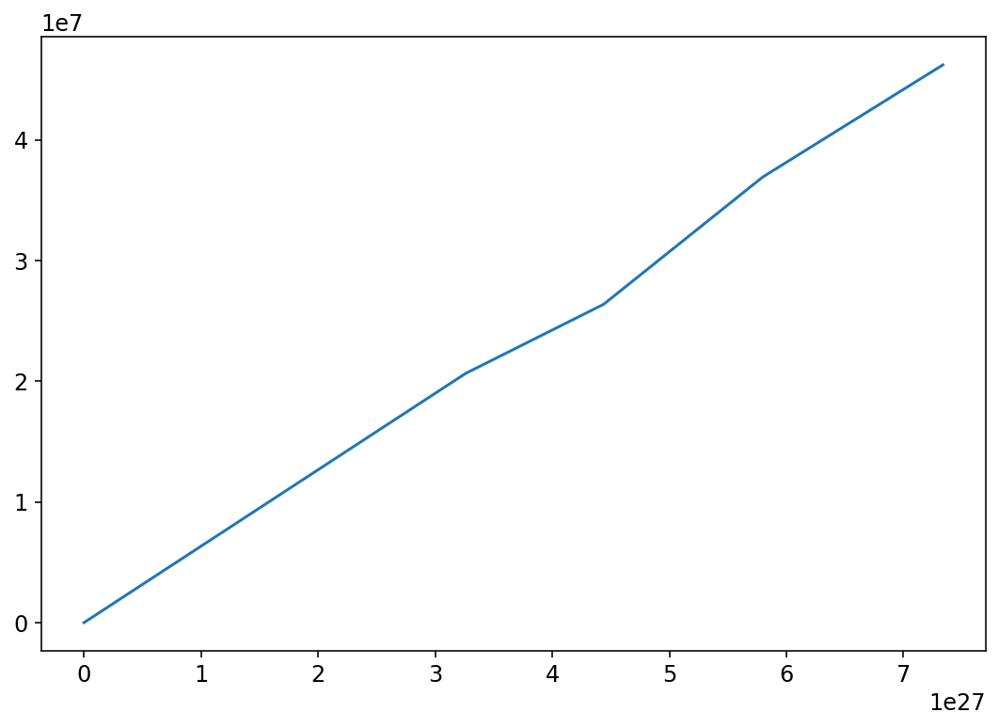

In [31]:
plt.plot(T, pressure_list)

### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.2.4</span>


Let's use lmfit to get the slope of $P$ vs $T$ graph. 

Firstly, scale the $x$ axis by $10^{-27}$ and the $y$ axis by $10^{-7}$.

Then, enter the slope of the fit after fitting to three significant digit. 

In [32]:
import lmfit
from lmfit import Model,Parameters #https://lmfit.github.io/lmfit-py/parameters.html
                                     #https://lmfit.github.io/lmfit-py/model.html#lmfit.model.Model

[[Model]]
    Model(linear_model)
[[Fit Statistics]]
    # fitting method   = leastsq
    # function evals   = 7
    # data points      = 5
    # variables        = 2
    chi-square         = 0.09811628
    reduced chi-square = 0.03270543
    Akaike info crit   = -15.6551995
    Bayesian info crit = -16.4363237
    R-squared          = 0.99204215
[[Variables]]
    a:  0.63038855 +/- 0.01624980 (2.58%) (init = 2.7)
    b: -0.02304020 +/- 0.07886430 (342.29%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(a, b) = -0.8585


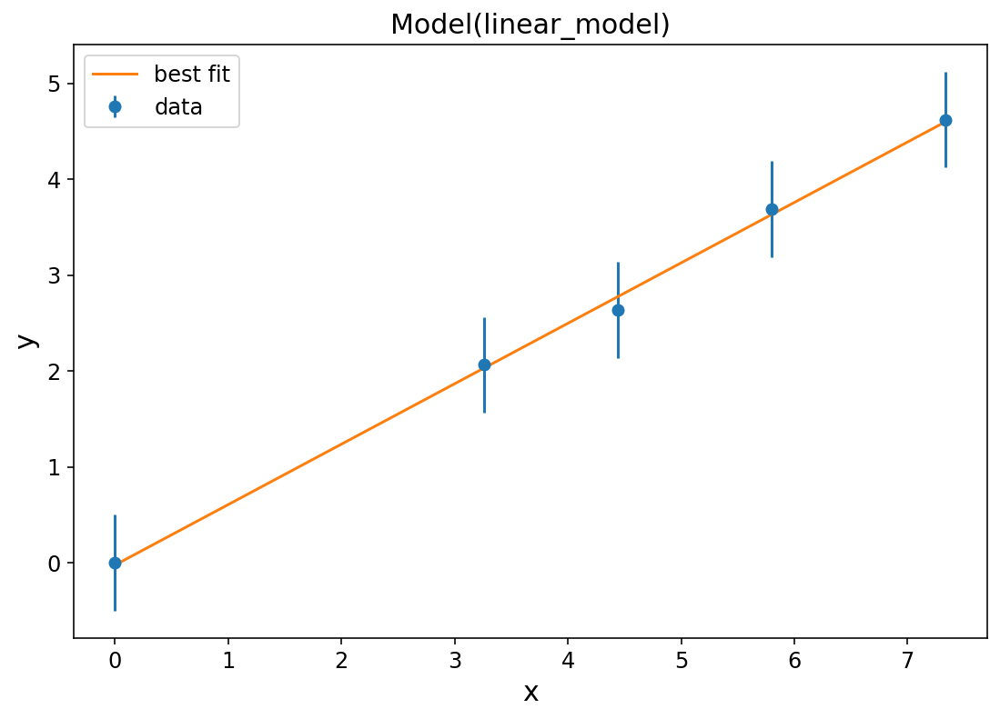

In [33]:
from lmfit.models import Model

def linear_model(x, a, b):
    return a*x+b

lmod = Model(linear_model)
lmod.set_param_hint(name = 'a', value = 2.7)
lmod.set_param_hint(name = 'b', value = 0)
result = lmod.fit(np.array(pressure_list)*1e-7, x = T*1e-27, weights = (2)*np.ones(len(pressure_list)))
print(result.fit_report())
result.plot_fit()
plt.show()

### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.2.5</span>


As a next step, let's confirm pressure version of Avogadro's law.

In other words, let's show that with temperature and volume fixed, $P \propto N$, where $N$ is the number of particles. 

Enter the value of the pressure when the number of particles is equal to 450

In [35]:
npoints = 2000
simulation_steps = 40000
dt = 0.0000008
nparticles_list = [300,350, 400,450, 500]
pressure_list = []
v_magnitude= 500
for n_particles in nparticles_list:
    vel_initial = np.zeros((n_particles,2))
    np.random.seed(673720454)
    pos_initial = np.random.rand(n_particles, 2)
    thetas = np.random.rand(n_particles)* 2 * np.pi
    vel_initial[:, 0] = np.cos(thetas) * v_magnitude
    vel_initial[:, 1] = np.sin(thetas) * v_magnitude
    pos_sim, vel_sim, dv_sim = simulate(pos_initial, vel_initial, simulation_steps, dt)
    pressure = compute_pressure(dv_sim, npoints, dt)
    pressure_list.append(pressure)

print(pressure_list[3])

37593275.94560493
49259421.50194695
59943970.20738483
69045941.4853003
82658198.176236
69045941.4853003


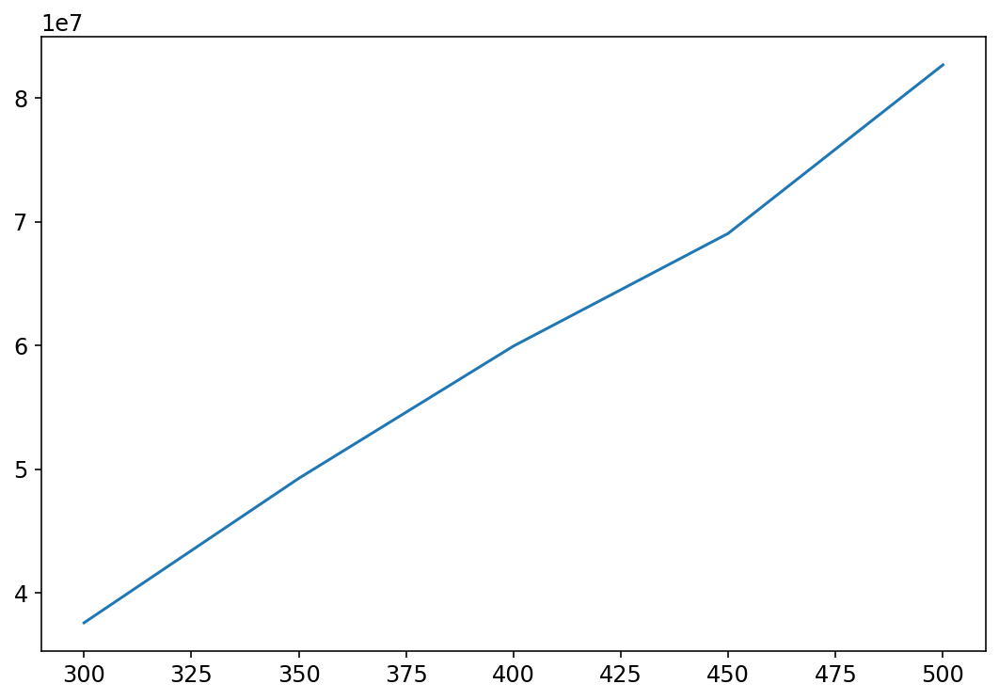

In [37]:
plt.plot(nparticles_list, pressure_list)

### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.2.6</span>


Finally, let's check Boyle's Law. 

We have to show that when we fix the number of particles and temperature, $P \propto \frac{1}{V}$

In order to do that, we should be able to vary the volume of the simulation by changing the side length variable `L` in the code.

Firstly, edit the code for the function `wall_collision` so taht you can vary the wall side length `L`. 

Then, enter the pressure value when the area of the container is equal to $4$.

Finally draw the plot of the plot $P$ vs $\frac{1}{V}$

In [ ]:
L = 1
def wall_collision(pos, vel):
    #collsion with the right wall 
    vel[pos[:, 0] > L, 0] = # Your code goes here. 

    #collision with the left wall 
    vel[pos[:, 0] < 0, 0] = # Your code goes here. 

    #collision with the top wall 
    vel[pos[:, 1] > L, 1] = # Your code goes here. 

    #collsion with the bottom wall 
    vel[pos[:, 1] < 0, 1] = # Your code goes here. 
    return vel 

In [41]:
L = 1
def wall_collision(pos, vel):
    # Your code goes here. 
    #collsion with the right wall 
    vel[pos[:, 0] > L, 0] = -np.abs(vel[pos[:, 0] > L, 0])

    #collision with the left wall 
    vel[pos[:, 0] < 0, 0] = np.abs(vel[pos[:, 0] < 0, 0])

    #collision with the top wall 
    vel[pos[:, 1] > L, 1] = -np.abs(vel[pos[:, 1] > L, 1])

    #collsion with the bottom wall 
    vel[pos[:, 1] < 0, 1] = np.abs(vel[pos[:, 1] < 0, 1])
    return vel 

In [42]:
npoints = 2000
simulation_steps = 40000
dt = 0.0000008
pressure_list = []
L_list = np.array([1,1.5,2,2.5,3])
n_particles = 400
np.random.seed(673720454)
pos_initial = np.random.rand(n_particles, 2)
for L in L_list:
    vel_initial = np.zeros((n_particles,2))
    np.random.seed(673720454)
    thetas = np.random.rand(n_particles)* 2 * np.pi
    vel_initial[:, 0] = np.cos(thetas) * v_magnitude
    vel_initial[:, 1] = np.sin(thetas) * v_magnitude
    pos_sim, vel_sim, dv_sim = simulate(pos_initial, vel_initial, simulation_steps, dt)
    pressure = compute_pressure(dv_sim, npoints, dt)
    pressure_list.append(pressure)
    #print(pressure)
print(pressure_list[2])

25841885.103488542


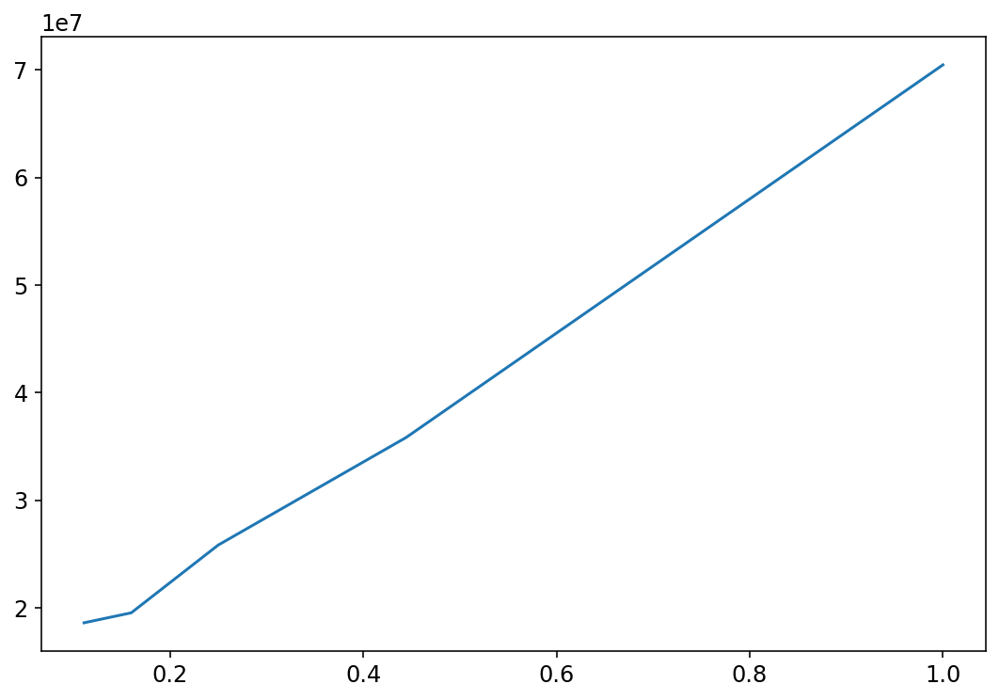

In [43]:
plt.plot(1/(L_list**2), pressure_list)

### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Problem 4.2.7</span>

Final Derivation

We've confimred that 
* with $N$ and $V$ fixed, $P \propto T$
* with $V$ and $T$ fixed, $P \propto N$
* with $T$ and $N$ fixed, $P \propto \frac{1}{V}$

Thus combining them all, we get that $\frac{PV}{NT} = C$ where $C$ is a constant.
Rearranging this equation, $\frac{P}{T} = C\frac{N}{V}$

In Problem 4.x, by fitting we got the value of $\frac{P}{T}$ with 400 particles and box of side length $1$. Using the fit value compute the value of $C$.

Hint. With 400 particles and the volume(area) = $1\times 1 = 1$, the slope in problem 4.x is $400C$



Is $C$ close to the value $k_B$ as we expect? Then rearranging the equation, we get $PV = Nk_B T$, the ideal gas relation in two dimensions. 
